# Chapter 5: Learning multiple weights at a time - generalizing gradient descent

In [24]:
import numpy as np
from sklearn.datasets import fetch_openml
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from matplotlib.colors import Normalize

## Gradient descent with multiple inputs and outputs

In [58]:
#    toes %win #fans
weights = np.array([
    [0.1, 0.1, -0.3],  # hurt?
    [0.1, 0.2, 0.0],  # win?
    [0.0, 1.3, 0.1]  # sad?
])


def neural_network(inpt, weights):
    pred = inpt.dot(weights)
    return pred


toes = np.array([8.5, 9.5, 9.9, 9.0])
wl_rec = np.array([0.65, 0.8, 0.8, 0.9])
n_fans = np.array([1.2, 1.3, 0.5, 1.0])

hurt = np.array([0.1, 0.0, 0.0, 0.1])
win = np.array([1, 1, 0, 1])
sad = np.array([0.1, 0.0, 0.1, 0.2])

alpha = 0.01

inpt = np.array([toes[0], wl_rec[0], n_fans[0]])
true = np.array([hurt[0], win[0], sad[0]])

pred = neural_network(inpt, weights)

error = (pred - true) ** 2

delta = pred - true

weight_deltas = np.outer(inpt, delta)

weights -= alpha * weight_deltas

pred_new = neural_network(inpt, weights)

error_new = (pred_new - true) ** 2

print(error - error_new)  # zmniejszanie się błędu

[0.61971112 2.21266422 5.97193559]


## Using gradient descent to train a neural network for MINST

In [2]:
mnist = fetch_openml('mnist_784', as_frame=False)

/home/m_zsuetam/anaconda3/envs/ml/lib/python3.8/site-packages/sklearn/datasets/_openml.py:968: FutureWarning: The default value of `parser` will change from `'liac-arff'` to `'auto'` in 1.4. You can set `parser='auto'` to silence this warning. Therefore, an `ImportError` will be raised from 1.4 if the dataset is dense and pandas is not installed. Note that the pandas parser may return different data types. See the Notes Section in fetch_openml's API doc for details.
  warn(


In [30]:
n = int(3e5)
X_train, X_test, y_train, y_test = train_test_split(
    mnist.data / 255.0,
    mnist.target,
    test_size=0.2,
    shuffle=True
)
# X_train = X_train[:n]
# y_train = y_train[:n]
# X_test = X_test[:n]
# y_test = y_test[:n]

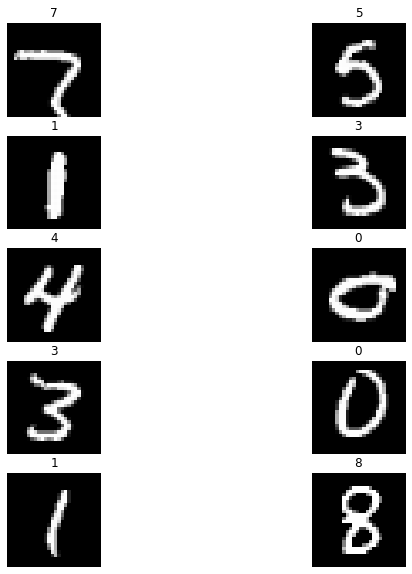

In [31]:
fig, axarr = plt.subplots(5, 2, figsize=(10, 10))

for i in range(10):
    axarr[i // 2, i % 2].imshow(X_train[i].reshape(28, 28), cmap='gray')
    axarr[i // 2, i % 2].axis('off')
    axarr[i // 2, i % 2].set_title(y_train[i])

[0] 0. Error: 1.0
[0] 1. Error: 1.0400713889943551
[0] 2. Error: 1.1235418520594223
[0] 3. Error: 1.2658601465434365
[0] 4. Error: 1.2134756939869558
[0] 5. Error: 1.2872288954240707
[0] 6. Error: 0.8625928733660189
[0] 7. Error: 0.41144950014146403
[0] 8. Error: 0.5856663242515219
[0] 9. Error: 1.4717335687226474
[0] 10. Error: 1.3789850121561003
[0] 11. Error: 0.8707601342405348
[0] 12. Error: 1.095569348855281
[0] 13. Error: 0.7460857900889166
[0] 14. Error: 1.358883903707858
[0] 15. Error: 0.8658279014755149
[0] 16. Error: 1.191273266917498
[0] 17. Error: 0.2749879265547054
[0] 18. Error: 0.9860032131423999
[0] 19. Error: 0.11726214960483747
[0] 20. Error: 1.1253025054026966
[0] 21. Error: 0.13859718377033647
[0] 22. Error: 1.5427118626034078
[0] 23. Error: 0.7513817463657558
[0] 24. Error: 0.07883021793727989
[0] 25. Error: 1.436389704895835
[0] 26. Error: 0.767528333643496
[0] 27. Error: 0.4091266476603865
[0] 28. Error: 1.1611672248388722
[0] 29. Error: 0.7550476441840838
[0] 30

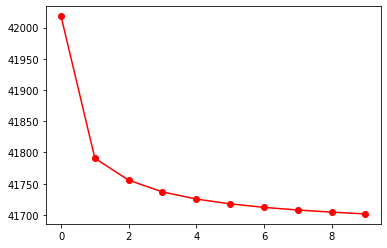

In [32]:
weights = np.zeros((784, 10))


def neural_network(inpt, weights):
    pred = inpt.dot(weights)
    return pred


alpha = 0.01


def update_weights(inpt, true, weights=weights, alpha=alpha):
    pred = neural_network(inpt, weights)
    error = (pred - true) ** 2
    delta = pred - true
    weight_deltas = np.outer(inpt, delta)
    weights -= alpha * weight_deltas
    return sum(error)

def train(X, y, epochs=10, weights=weights):
    err_sums = []
    for j in range(epochs):
        mean = 0
        for i in range(len(X)):
            inpt = X[i]
            true = np.zeros(10)
            true[int(y[i])] = 1
            err = update_weights(inpt, true)
            print(f"[{j}] {i}. Error: {err}")
            mean += err
        mean /= len(X)
        err_sums.append(mean)
    return err_sums

mean_errs = train(X_train, y_train, epochs=10)

plt.plot(mean_errs, label='Mean error', color='red', marker='o')
plt.show()

In [5]:
def compute_accuracy(X,y):
    accuracy = 0
    for i in range(len(X)):
        inpt = X[i]
        true = np.zeros(10)
        true[int(y[i])] = 1
        pred = neural_network(inpt, weights)
        if np.argmax(pred) == np.argmax(true):
            accuracy += 1
    return accuracy / len(X)

print(f"Accuracy (train): {compute_accuracy(X_train, y_train)}")
print(f"Accuracy (test): {compute_accuracy(X_test, y_test)}")

Accuracy (train): 0.7385714285714285
Accuracy (test): 0.7314285714285714


### Visualizing weight values

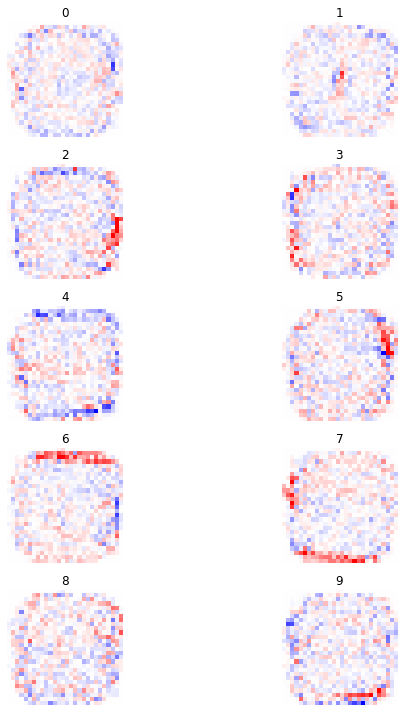

In [29]:
# Create a figure and axes
fig, axarr = plt.subplots(5, 2, figsize=(10, 10))

# Flatten the axes array
axarr = axarr.flatten()

# Iterate over the axes and weights to display the images
for i, ax in enumerate(axarr):
    new_weights = weights[:,i].reshape(28, 28)
    # new_weights = new_weights ** 2
    # new_weights /= new_weights.max() * 255
    ax.imshow(new_weights, cmap='bwr', norm=Normalize(vmin=-0.2, vmax=.2))  # Assuming grayscale images
    ax.axis('off')  # Turn off the axis labels
    ax.set_title(f"{i}")  # Add a title to each subplot

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()